# Visium data - QC and Exploratory data analysis

Following the [scanpy vignettes](https://scanpy-tutorials.readthedocs.io/en/latest/spatial/basic-analysis.html) and [squidpy vignettes](https://squidpy.readthedocs.io/en/latest/auto_tutorials/tutorial_visium_hne.html)

In [43]:
import os,sys
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns

In [148]:
import anndata

In [2]:
import scanpy as sc
import anndata as ad
import squidpy as sq

import numpy as np
import pandas as pd

sc.logging.print_header()
print(f"squidpy=={sq.__version__}")


scanpy==1.8.1 anndata==0.7.6 umap==0.4.6 numpy==1.20.2 scipy==1.5.2 pandas==1.1.2 scikit-learn==0.23.2 statsmodels==0.12.0 python-igraph==0.9.0 louvain==0.7.0 leidenalg==0.8.3 pynndescent==0.5.2
squidpy==1.1.0


### Load datasets

Mapped without corresponding images by `ktpolanski`, using a dummy image.

In [13]:
raw_data_dir = '/lustre/scratch117/cellgen/team205/sharedData/ed6/visium-noimage-hack/'

In [34]:
folders = [raw_data_dir + x + "/outs/" for x in os.listdir(raw_data_dir) if not x.endswith("mro") and x.startswith("WSS")]

In [93]:
adatas = []
for f in folders:
    a = sc.read_visium(f, count_file='raw_feature_bc_matrix.h5')
    a.obs["data_path"] = f
    a.obs["Sample.lanes"] = [x[-3] for x in a.obs.data_path.str.split("/")]
    adatas.append(a)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Vari

Add metadata

In [70]:
visium_meta = pd.read_csv("/home/jovyan/mount/gdrive/Pan_fetal/meta_share/p_fetal_visium_lp1_lp2_lp3.csv", header=None)
visium_meta.columns = ["Sample.lanes", "Sample", "organ", "donor"]

In [95]:
for i in range(len(adatas)):
    new_obs = pd.merge(adatas[i].obs, visium_meta, how="left")
    new_obs.index = adatas[i].obs_names
    adatas[i].obs = new_obs.copy()

Quick check 

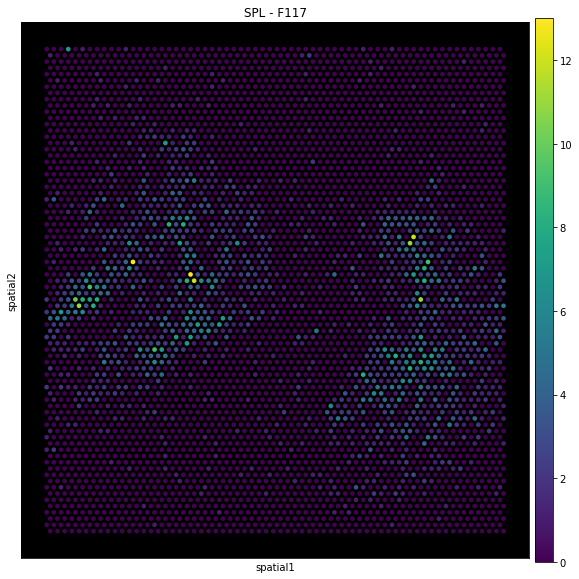

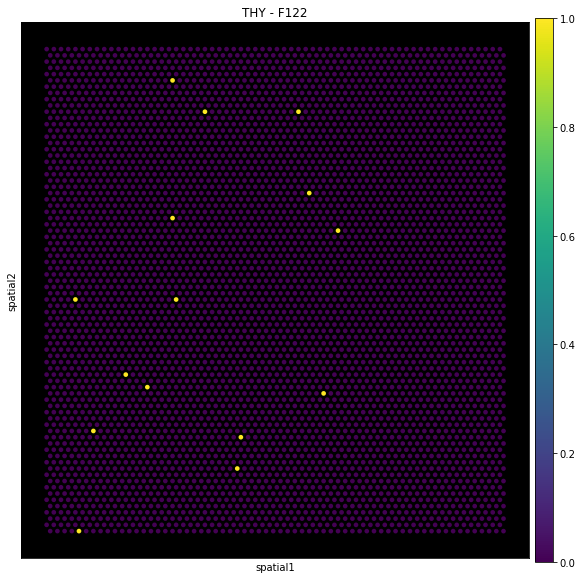

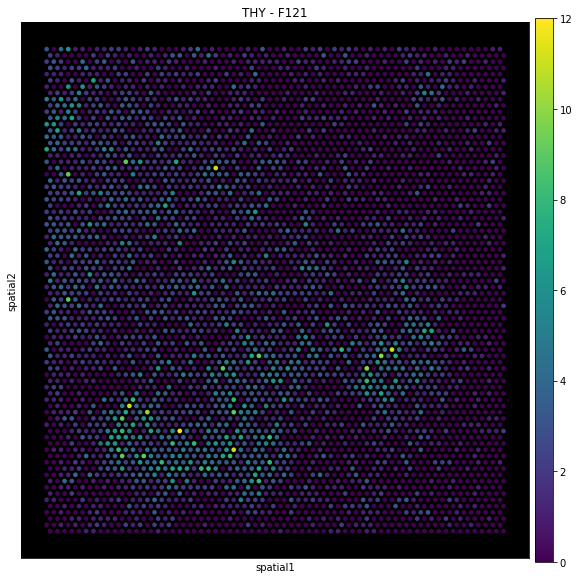

... storing 'data_path' as categorical
... storing 'Sample.lanes' as categorical
... storing 'Sample' as categorical
... storing 'organ' as categorical
... storing 'donor' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


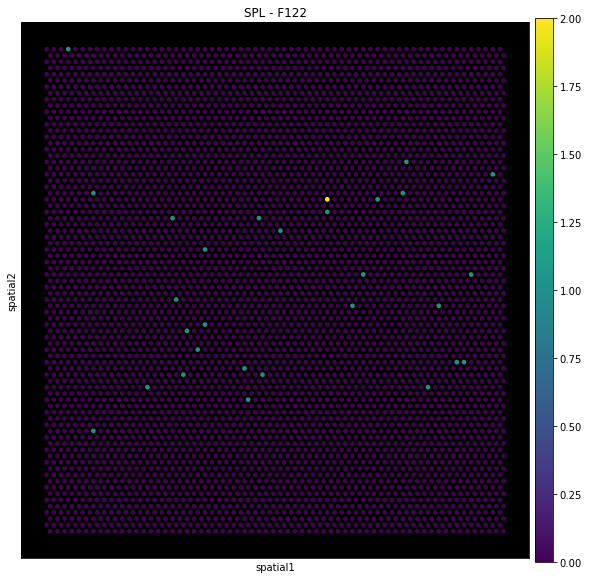

... storing 'data_path' as categorical
... storing 'Sample.lanes' as categorical
... storing 'Sample' as categorical
... storing 'organ' as categorical
... storing 'donor' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


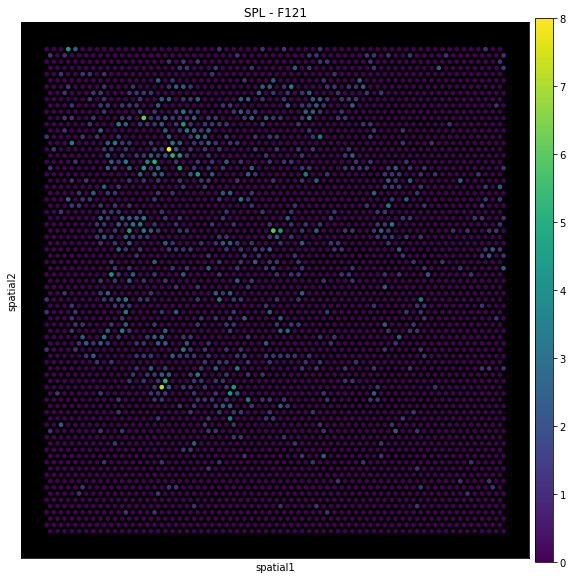

... storing 'data_path' as categorical
... storing 'Sample.lanes' as categorical
... storing 'Sample' as categorical
... storing 'organ' as categorical
... storing 'donor' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


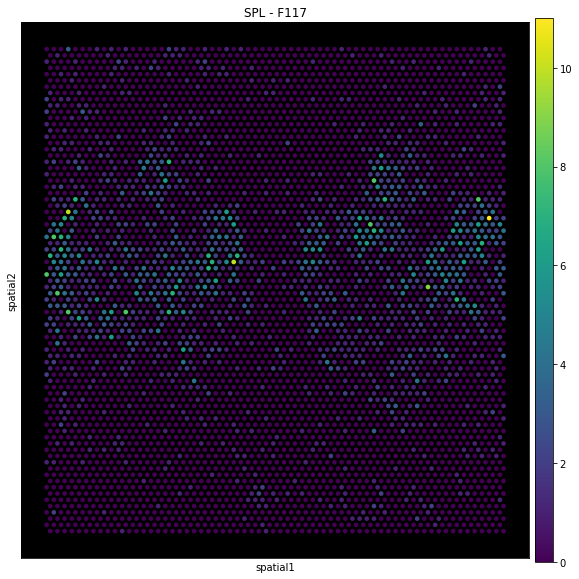

... storing 'data_path' as categorical
... storing 'Sample.lanes' as categorical
... storing 'Sample' as categorical
... storing 'organ' as categorical
... storing 'donor' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


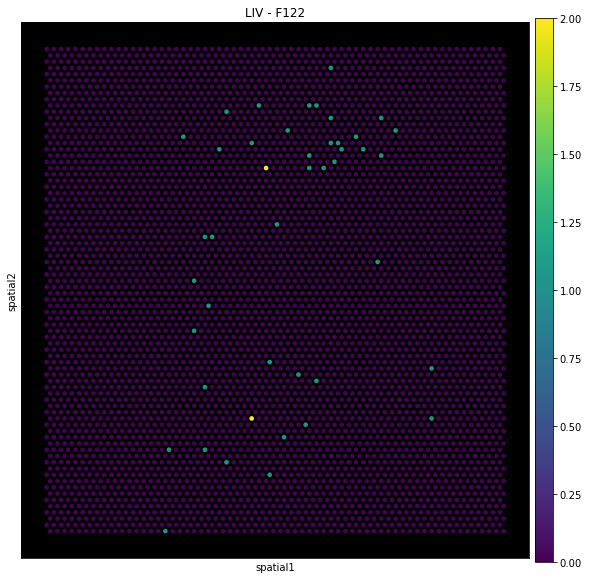

... storing 'data_path' as categorical
... storing 'Sample.lanes' as categorical
... storing 'Sample' as categorical
... storing 'organ' as categorical
... storing 'donor' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


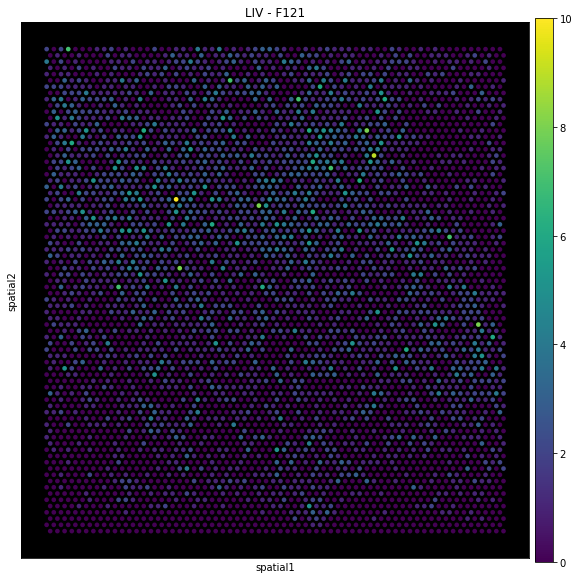

... storing 'data_path' as categorical
... storing 'Sample.lanes' as categorical
... storing 'Sample' as categorical
... storing 'organ' as categorical
... storing 'donor' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


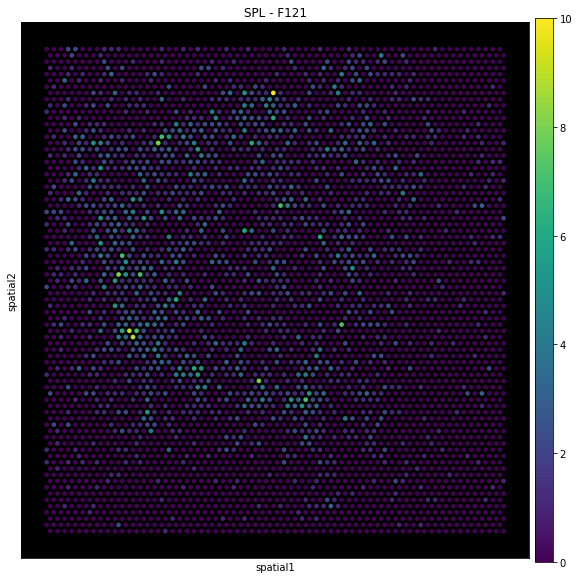

... storing 'data_path' as categorical
... storing 'Sample.lanes' as categorical
... storing 'Sample' as categorical
... storing 'organ' as categorical
... storing 'donor' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


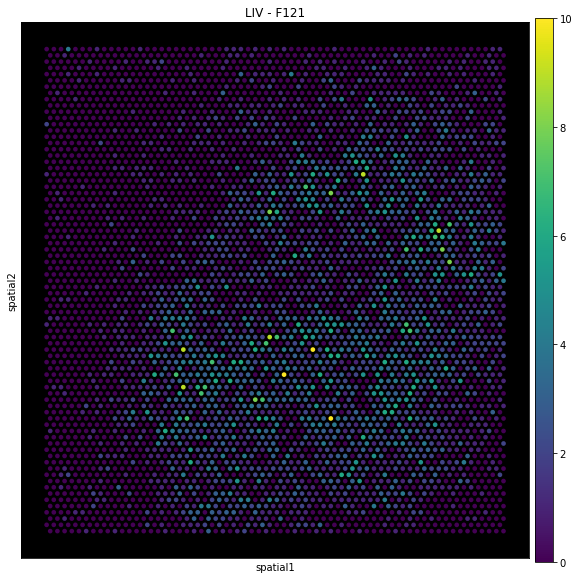

... storing 'data_path' as categorical
... storing 'Sample.lanes' as categorical
... storing 'Sample' as categorical
... storing 'organ' as categorical
... storing 'donor' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


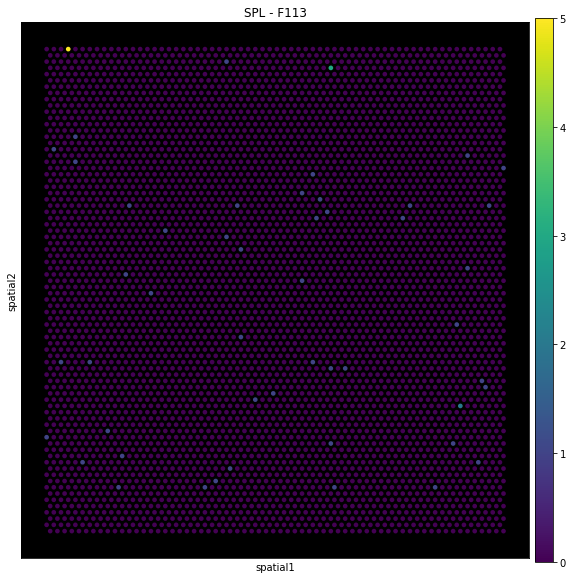

... storing 'data_path' as categorical
... storing 'Sample.lanes' as categorical
... storing 'Sample' as categorical
... storing 'organ' as categorical
... storing 'donor' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


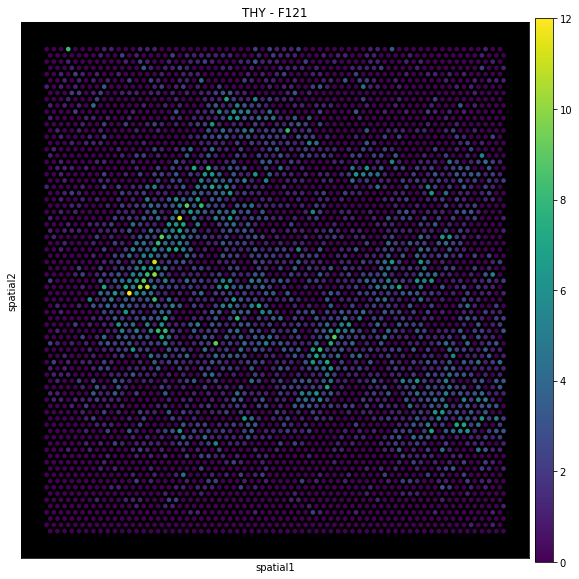

In [99]:
for a in adatas:
    plt.rcParams['axes.facecolor'] = "black"
    plt.rcParams["figure.figsize"] = [10,10]
    sc.pl.spatial(a, color="MKI67", alpha_img=0,
                  title="{o} - {d}".format(d=a.obs["donor"][0], o=a.obs["organ"][0])
                 )

### QC and Preprocessing

In [100]:
def pp_visium(adata):
    adata.var_names_make_unique()
    adata.var["mt"] = adata.var_names.str.startswith("MT-")
    sc.pp.calculate_qc_metrics(adata, qc_vars=["mt"], inplace=True)
    
[pp_visium(a) for a in adatas]

[None, None, None, None, None, None, None, None, None, None, None, None]

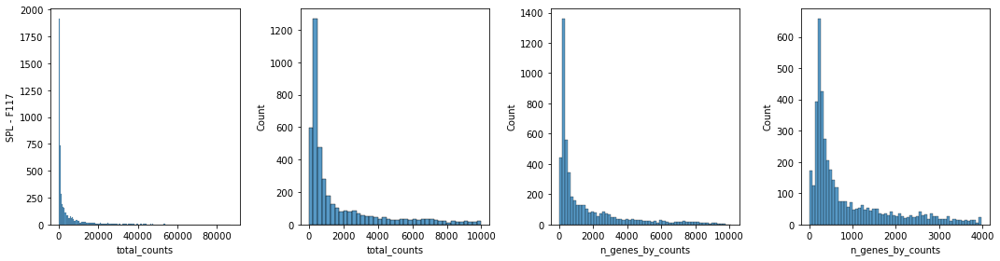

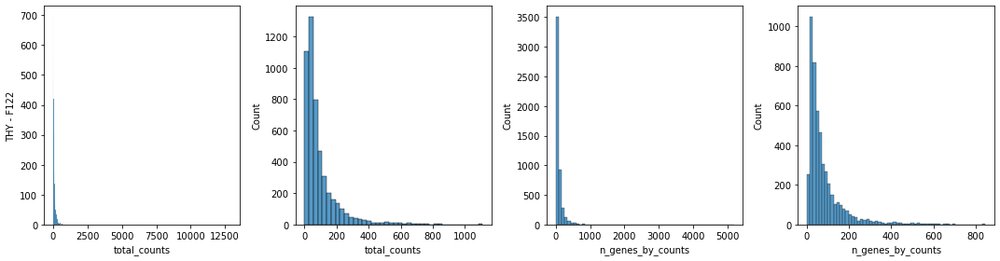

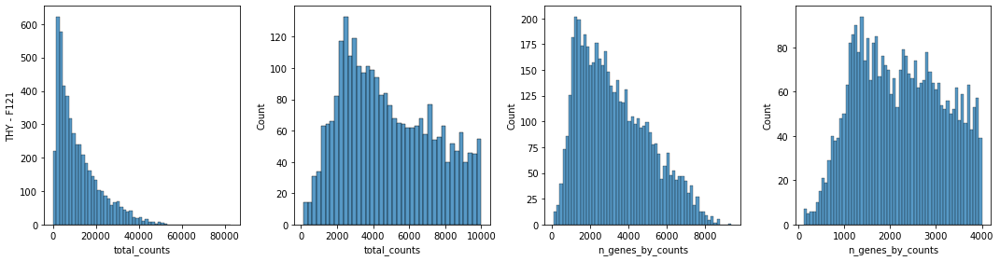

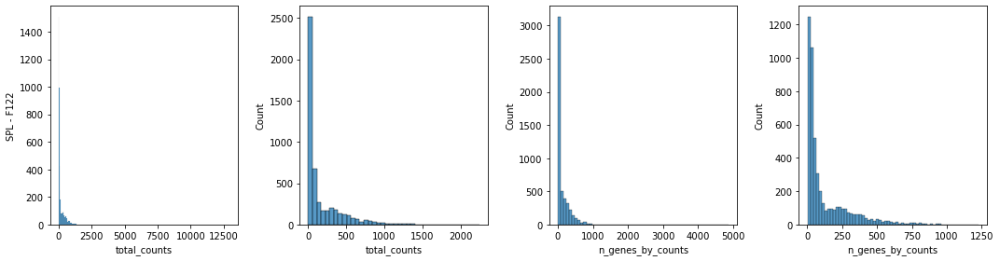

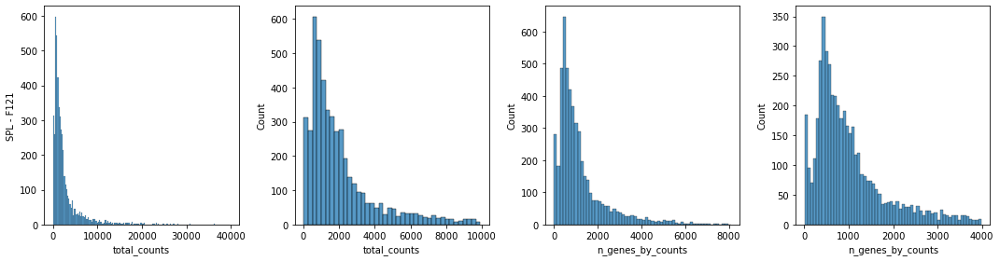

...

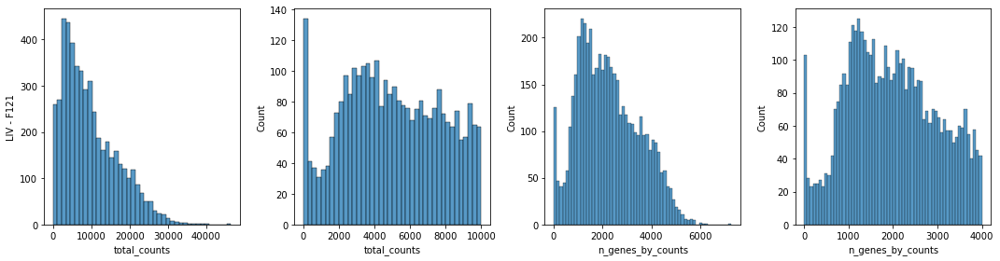

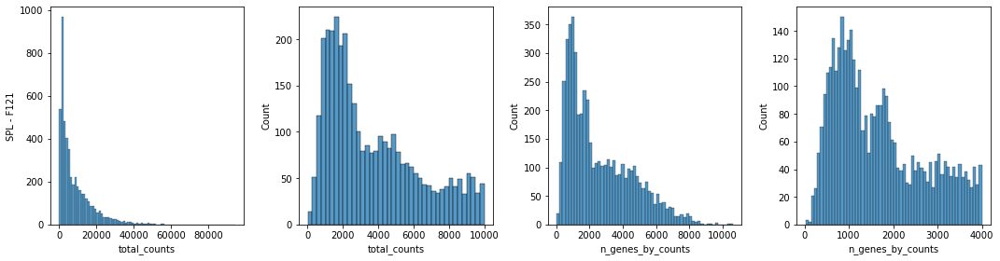

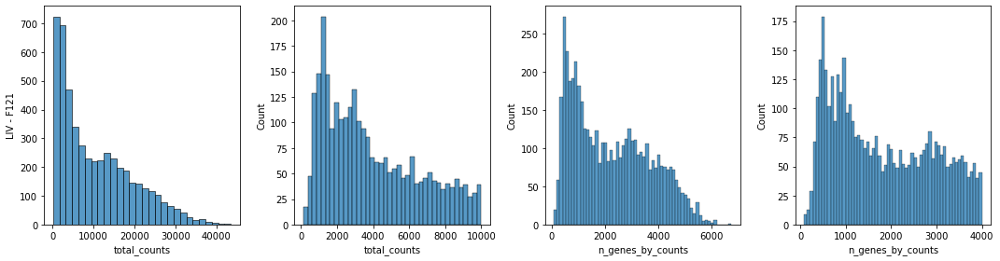

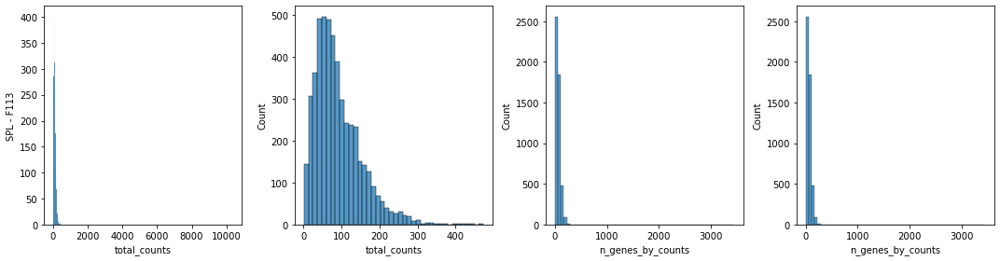

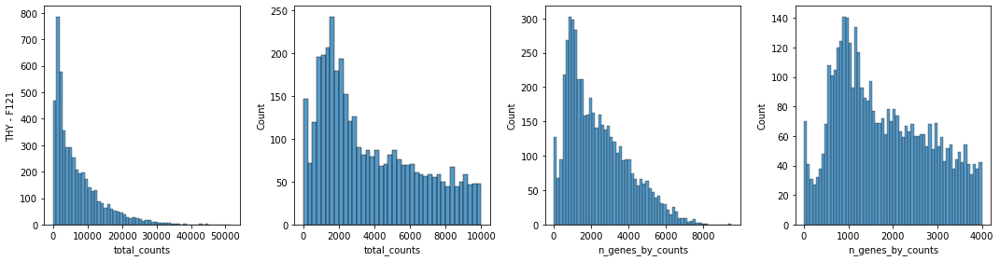

In [107]:
def plot_qc(adata, title):
    plt.rcParams['axes.facecolor'] = "white"
    fig, axs = plt.subplots(1, 4, figsize=(15, 4))
    sns.histplot(adata.obs["total_counts"], kde=False, ax=axs[0])
    sns.histplot(adata.obs["total_counts"][adata.obs["total_counts"] < 10000], kde=False, bins=40, ax=axs[1])
    sns.histplot(adata.obs["n_genes_by_counts"], kde=False, bins=60, ax=axs[2])
    sns.histplot(adata.obs["n_genes_by_counts"][adata.obs["n_genes_by_counts"] < 4000], kde=False, bins=60, ax=axs[3])
    axs[0].set_ylabel(t);
    plt.tight_layout()
    
for a in adatas:
    t="{o} - {d}".format(d=a.obs["donor"][0], o=a.obs["organ"][0])
    plot_qc(a, t)

Visualize QC metrics in space

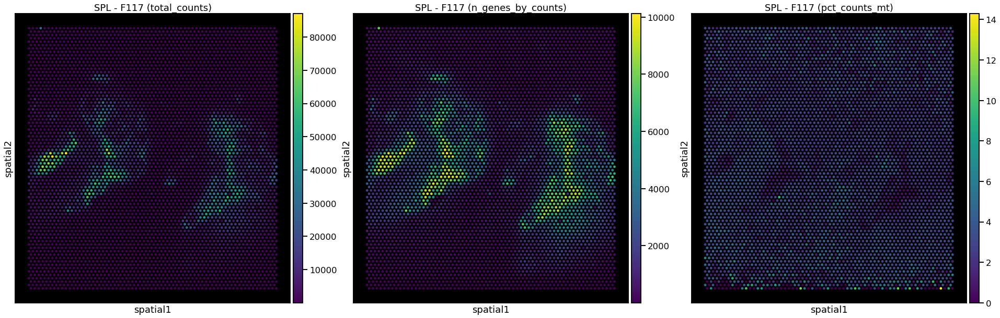

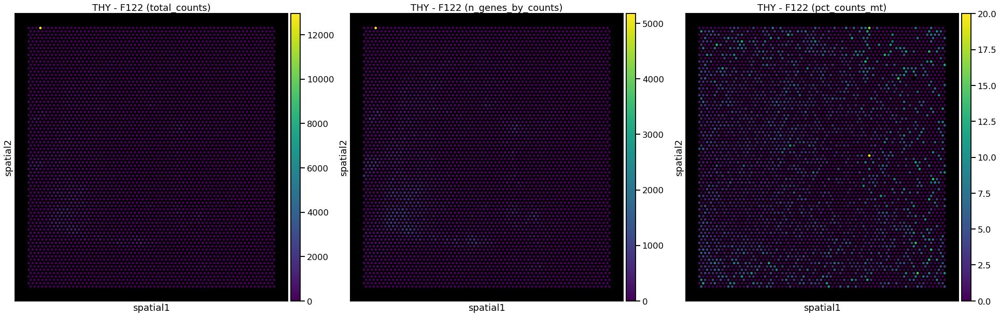

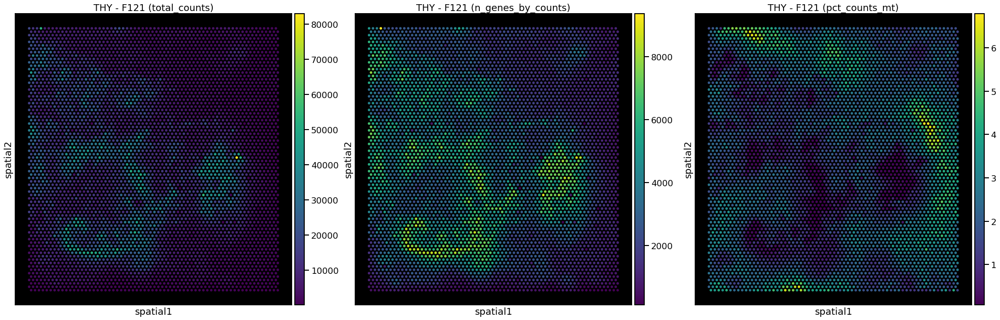

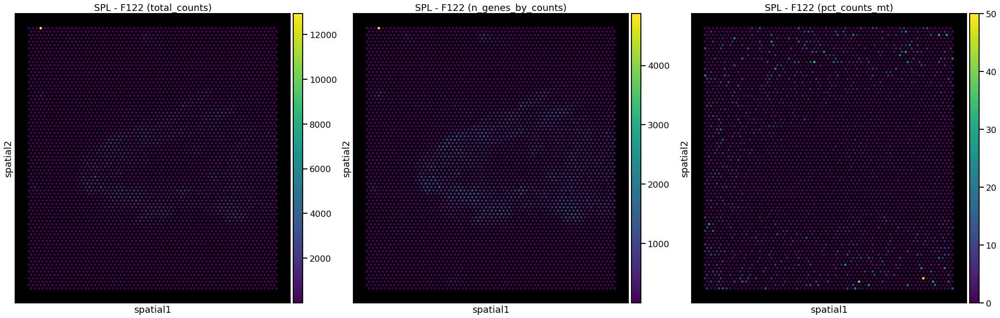

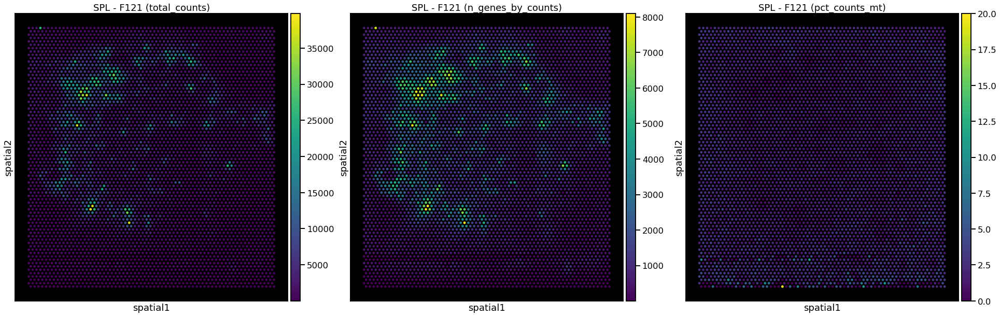

...

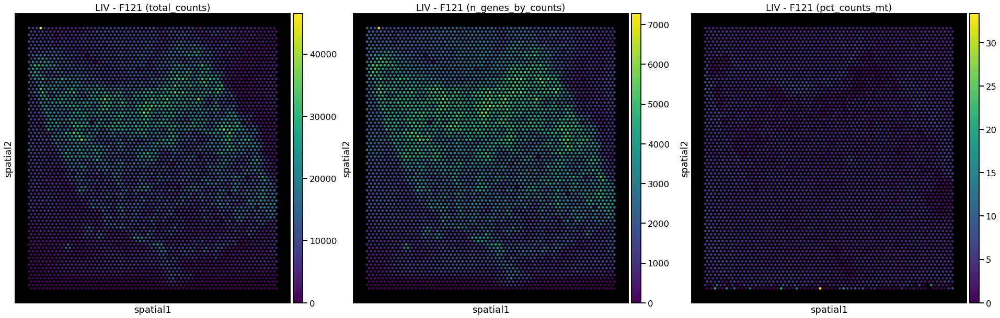

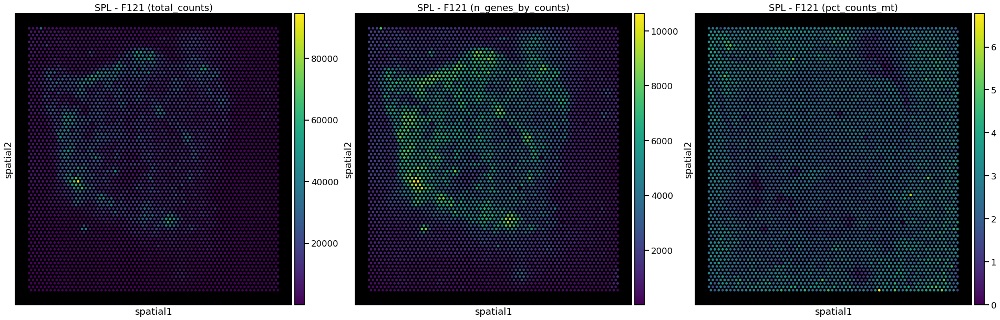

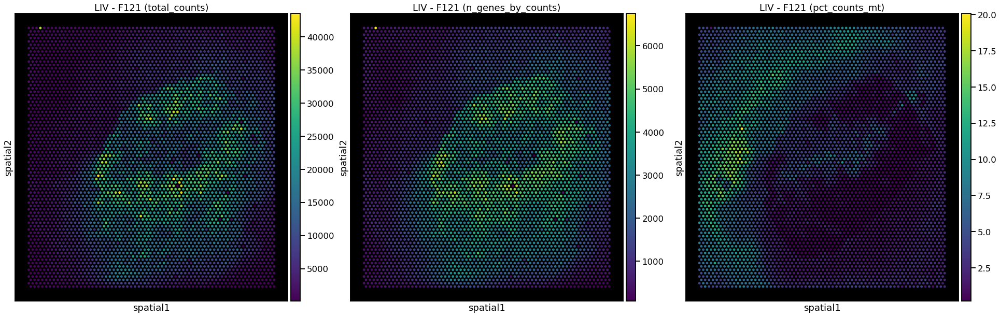

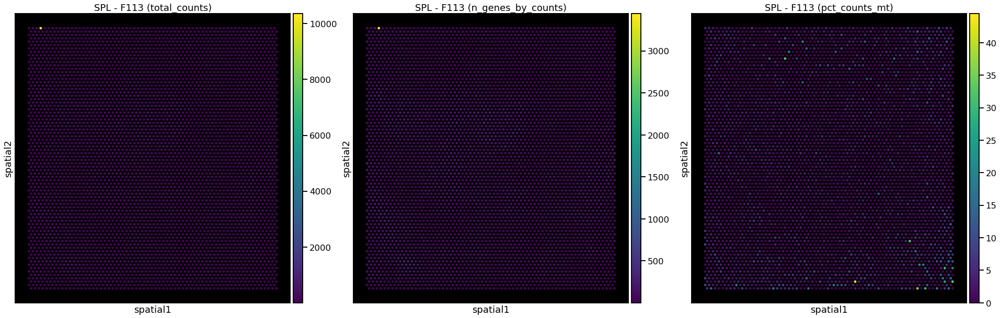

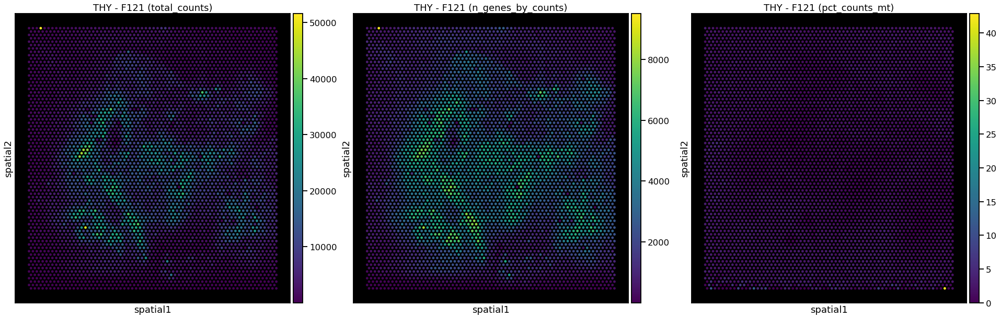

In [113]:
for a in adatas:
    plt.rcParams['axes.facecolor'] = "black"
    plt.rcParams["figure.figsize"] = [10,10]
    sns.set_context("talk")
    cols = ["total_counts", "n_genes_by_counts", "pct_counts_mt"]
    sc.pl.spatial(a, color=cols, alpha_img=0,
                  title=["{o} - {d} ({c})".format(d=a.obs["donor"][0], o=a.obs["organ"][0], c=c) for c in cols]
                 )

### Basic filtering

Lower bound: exclude empty spots / Upper bound: ?

In [115]:
for adata in adatas:
    sc.pp.filter_cells(adata, min_counts=2000)
    sc.pp.filter_cells(adata, max_counts=70000)
    #     a = a[a.obs["pct_counts_mt"] < 20]
    print(f"#cells after MT filter: {adata.n_obs}")
    sc.pp.filter_genes(adata, min_cells=10)

NameError: name 'adata' is not defined

In [116]:
def filter_visium(adata, min_counts=2000, max_counts=70000, min_cells=10):
    sc.pp.filter_cells(adata, min_counts=min_counts)
    sc.pp.filter_cells(adata, min_counts=min_counts)
    #     a = a[a.obs["pct_counts_mt"] < 20]
    print(f"#cells after MT filter: {adata.n_obs}")
    sc.pp.filter_genes(adata, min_cells=min_cells)
    
[filter_visium(a) for a in adatas]

#cells after MT filter: 1885
#cells after MT filter: 1
#cells after MT filter: 4668
#cells after MT filter: 2
#cells after MT filter: 1909
#cells after MT filter: 2339
#cells after MT filter: 1
#cells after MT filter: 4545
#cells after MT filter: 3786
#cells after MT filter: 4145
#cells after MT filter: 1
#cells after MT filter: 3630


[None, None, None, None, None, None, None, None, None, None, None, None]

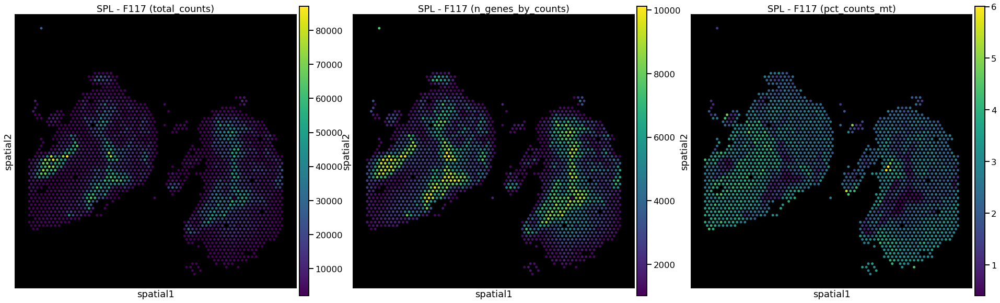

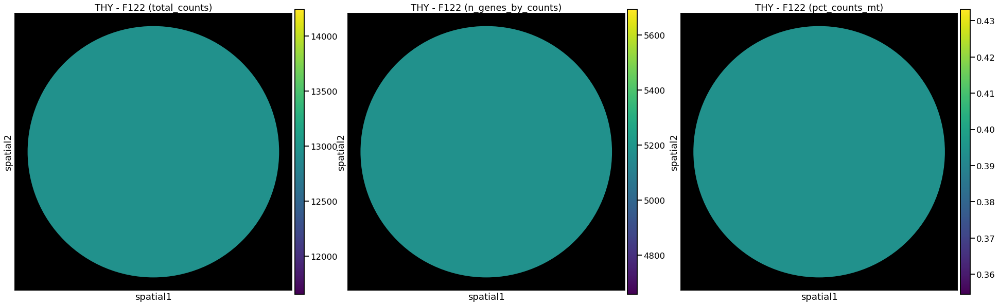

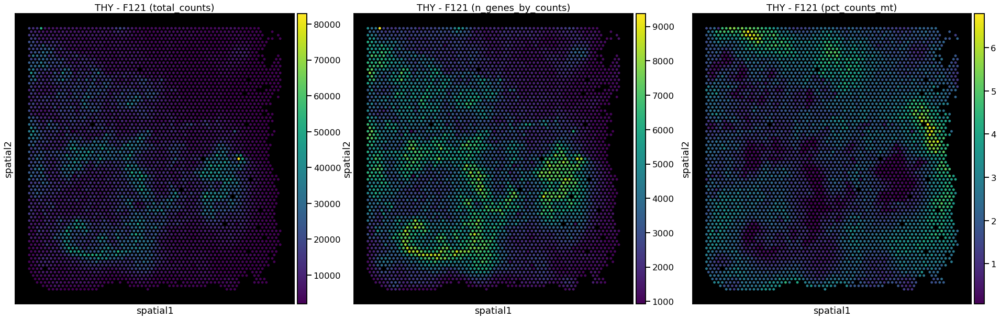

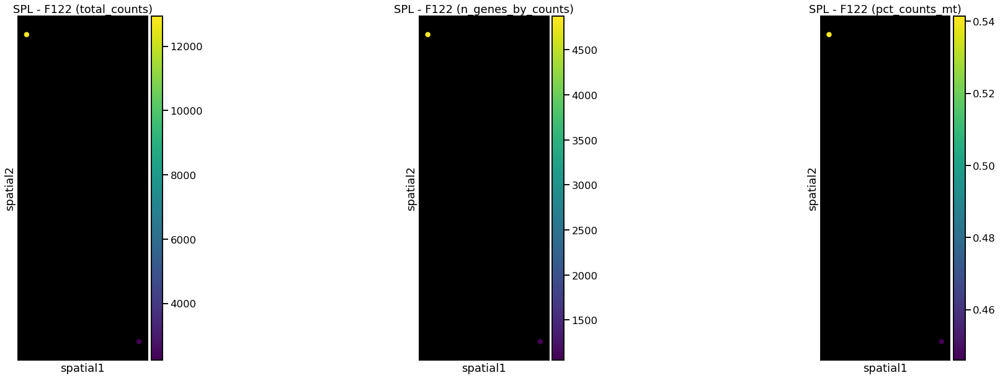

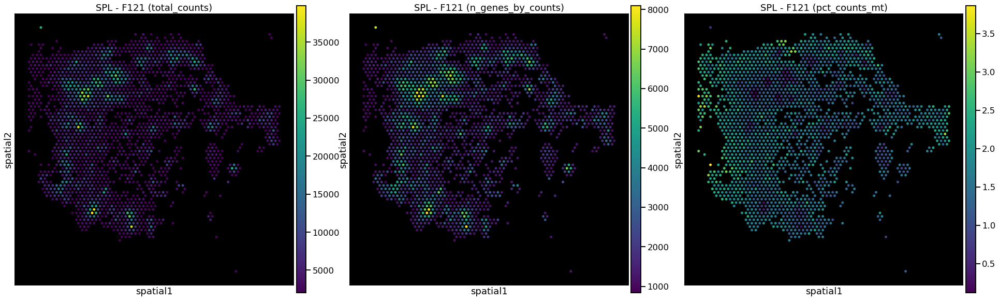

...

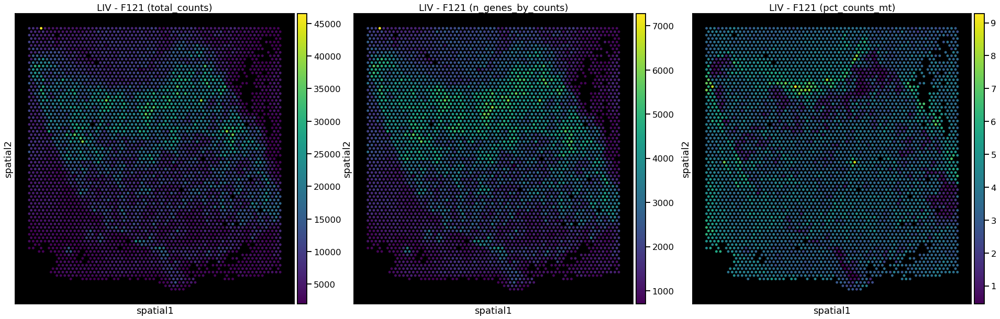

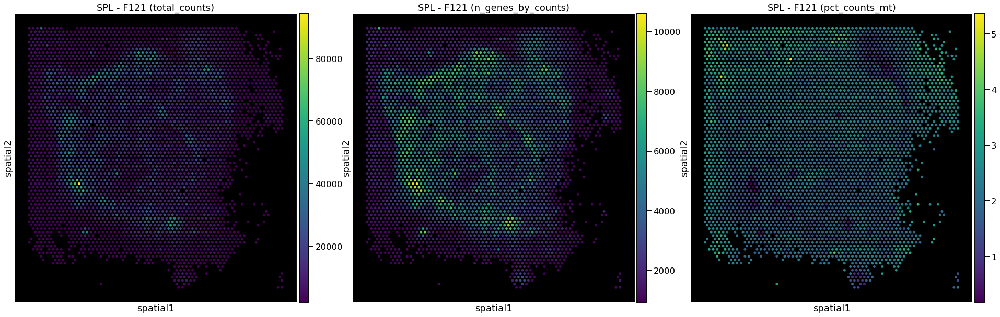

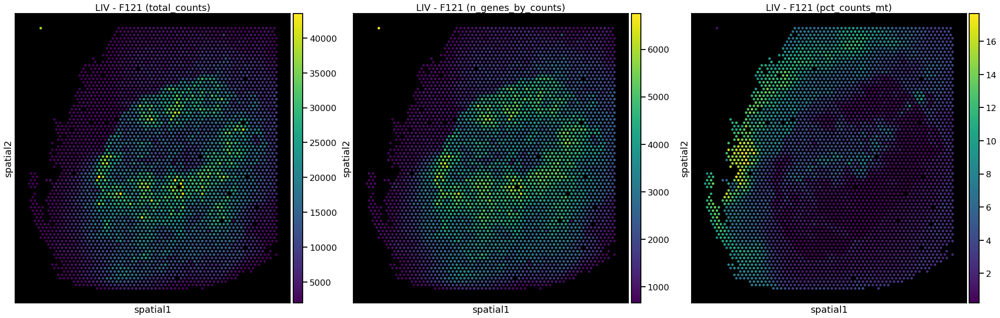

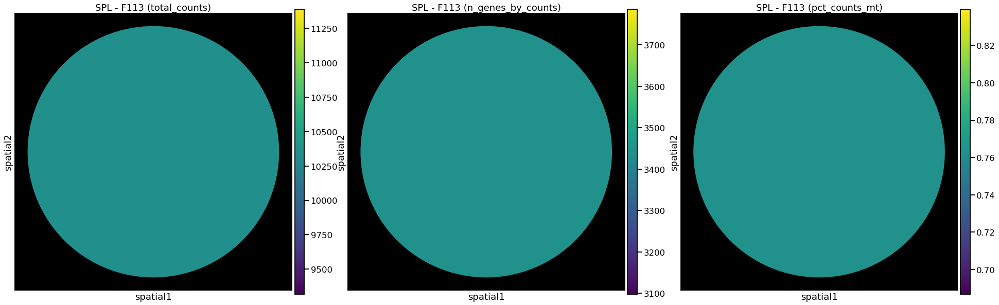

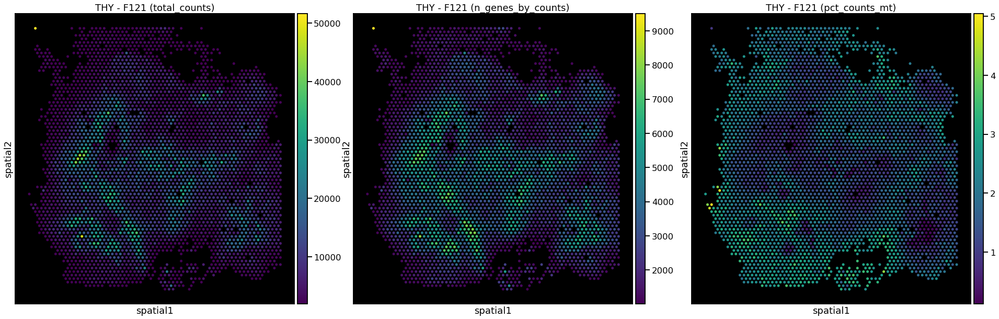

In [117]:
for a in adatas:
    plt.rcParams['axes.facecolor'] = "black"
    plt.rcParams["figure.figsize"] = [10,10]
    sns.set_context("talk")
    cols = ["total_counts", "n_genes_by_counts", "pct_counts_mt"]
    sc.pl.spatial(a, color=cols, alpha_img=0,
                  title=["{o} - {d} ({c})".format(d=a.obs["donor"][0], o=a.obs["organ"][0], c=c) for c in cols]
                 )

### Discard low quality samples

In [127]:
adatas_keep = [a for a in adatas if a.n_obs > 1000]

### Normalization

In [157]:
def norm_visium(adata):
    sc.pp.normalize_total(adata, inplace=True)
    sc.pp.log1p(adata)
    sc.pp.highly_variable_genes(adata, flavor="seurat", n_top_genes=2000)
    
[norm_visium(a) for a in adatas_keep]

[None, None, None, None, None, None, None, None]

### Check some marker genes

In [158]:
markers = [
    "PDGFRA", # fibroblasts
    "CD34", # progenitors
    "CD3D", # T cells
    "IGHM", # B cells
          ]

#### Liver samples

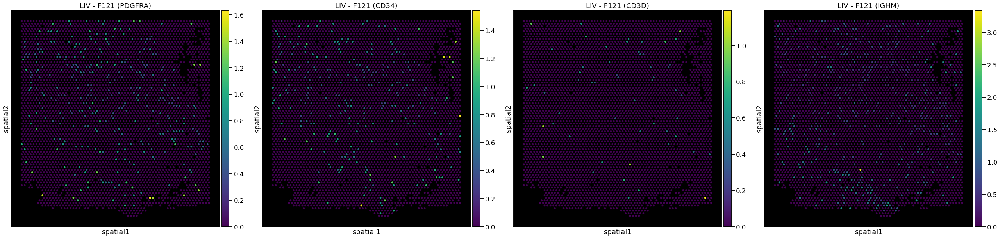

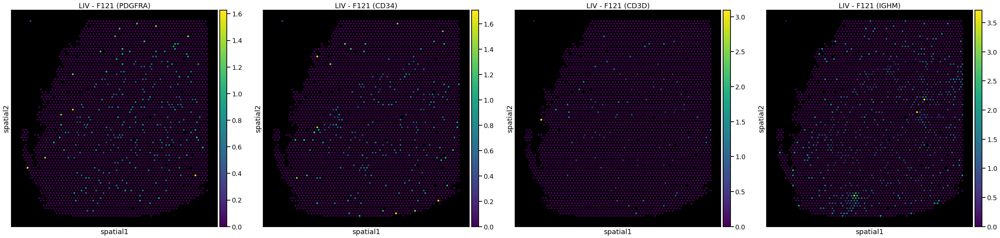

In [159]:
for a in adatas_keep:
    if a.obs["organ"][0] == "LIV":
        plt.rcParams['axes.facecolor'] = "black"
        plt.rcParams["figure.figsize"] = [10,10]
        sns.set_context("talk")
        cols = markers
        sc.pl.spatial(a, color=cols, alpha_img=0,
                      title=["{o} - {d} ({c})".format(d=a.obs["donor"][0], o=a.obs["organ"][0], c=c) for c in cols]
                     )

#### Thymus samples

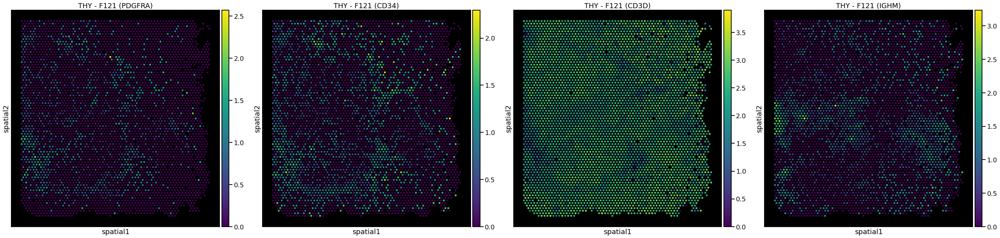

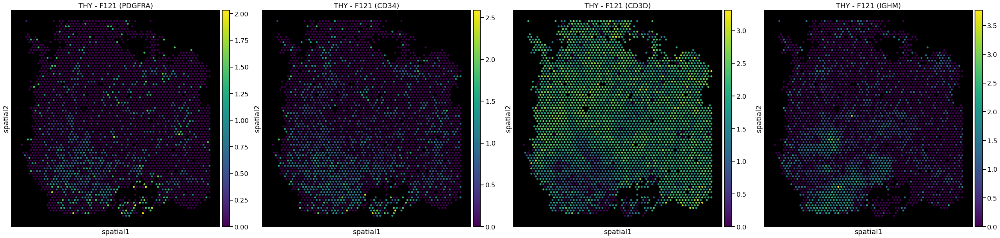

In [160]:
for a in adatas_keep:
    if a.obs["organ"][0] == "THY":
        plt.rcParams['axes.facecolor'] = "black"
        plt.rcParams["figure.figsize"] = [10,10]
        sns.set_context("talk")
        cols = markers
        sc.pl.spatial(a, color=cols, alpha_img=0,
                      title=["{o} - {d} ({c})".format(d=a.obs["donor"][0], o=a.obs["organ"][0], c=c) for c in cols]
                     )

#### Spleen samples

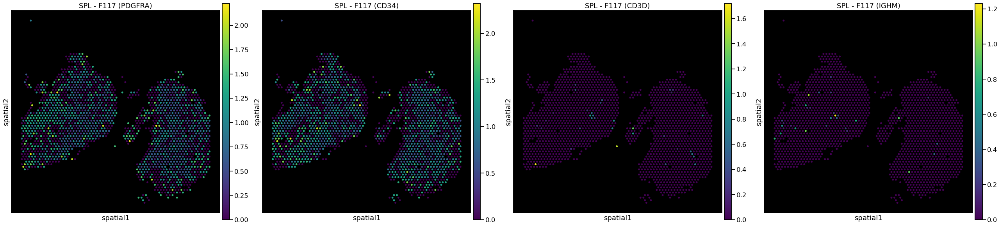

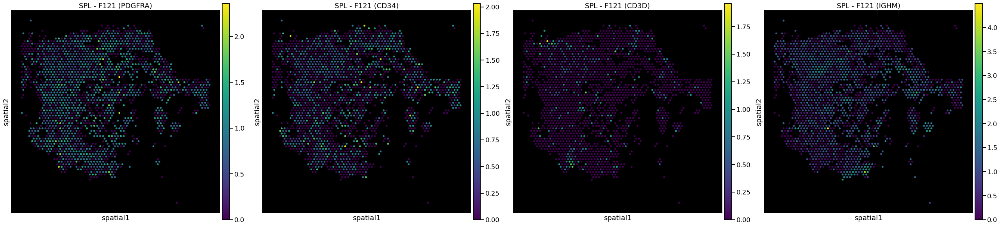

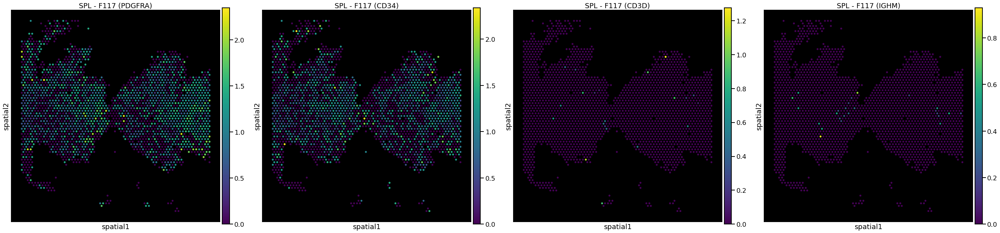

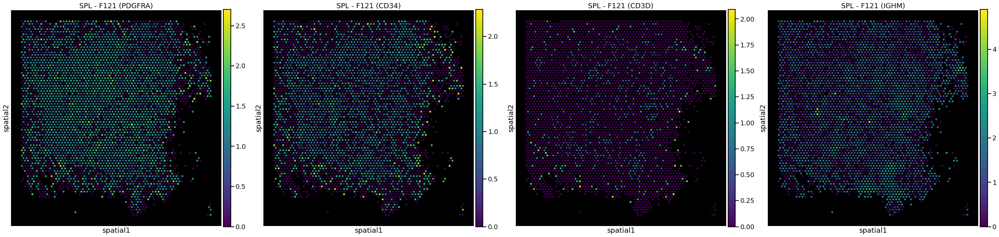

In [161]:
for a in adatas_keep:
    if a.obs["organ"][0] == "SPL":
        plt.rcParams['axes.facecolor'] = "black"
        plt.rcParams["figure.figsize"] = [10,10]
        sns.set_context("talk")
        cols = markers
        sc.pl.spatial(a, color=cols, alpha_img=0,
                      title=["{o} - {d} ({c})".format(d=a.obs["donor"][0], o=a.obs["organ"][0], c=c) for c in cols]
                     )

### Manifold embedding and clustering based on transcriptional similarity

Do spots from different slides of the same organ cluster together?

In [201]:
## Rename obs_names
for a in adatas_keep:
    a.obs_names = a.obs['Sample'][0] + "_" + a.obs_names

In [204]:
org = "LIV"

org_adatas = [a for a in adatas_keep if a.obs["organ"][0] == org]
samples = [a.obs["Sample"][0] for a in org_adatas]
org_adata = anndata.concat(org_adatas, label="sample", keys=samples)
org_hvgs = set(sum([list(a.var_names[a.var["highly_variable"]]) for a in org_adatas], []))
org_adata.var["highly_variable"] = org_adata.var_names.isin(org_hvgs)

sc.pp.pca(org_adata, use_highly_variable=True)
sc.pp.neighbors(org_adata)
sc.tl.umap(org_adata)
sc.tl.leiden(org_adata, key_added="clusters")

... storing 'data_path' as categorical
... storing 'Sample.lanes' as categorical
... storing 'Sample' as categorical


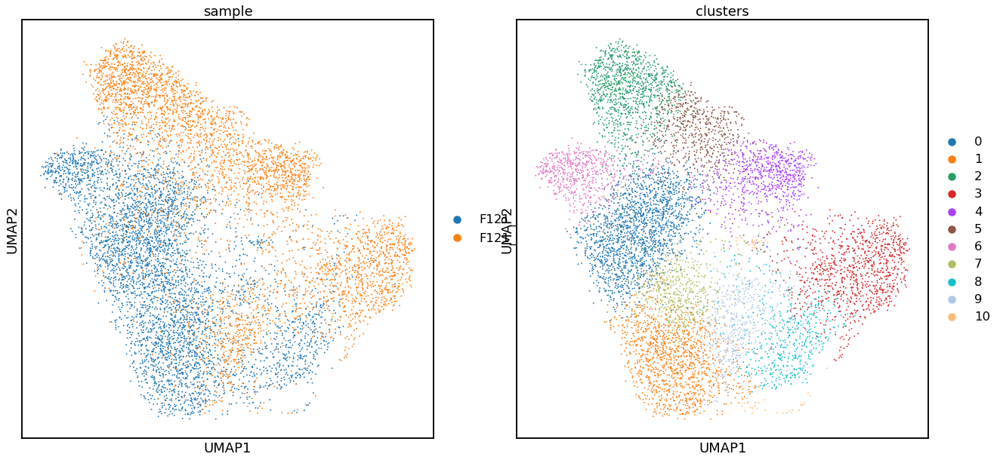

In [205]:
plt.rcParams['axes.facecolor'] = "white"
sc.pl.umap(org_adata, color=["sample","clusters"])

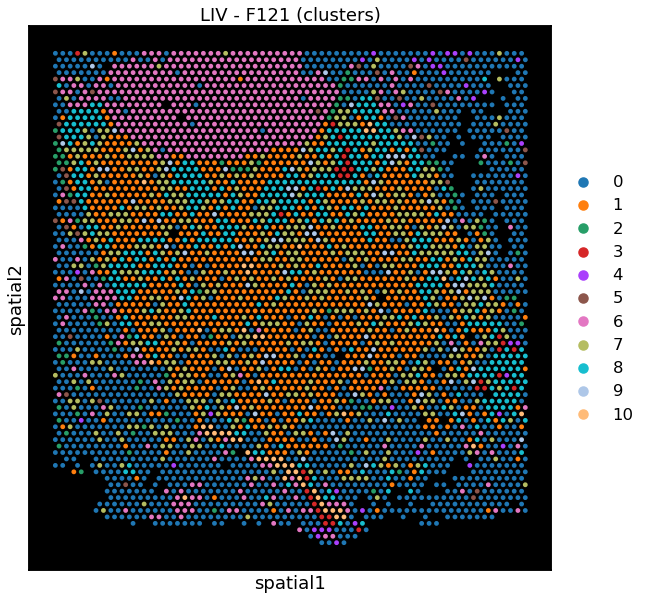

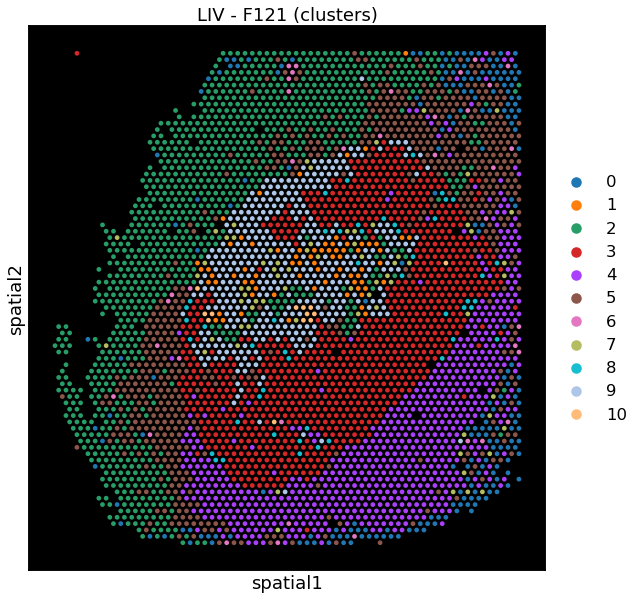

In [206]:
for a in org_adatas:
    plt.rcParams['axes.facecolor'] = "black"
    plt.rcParams["figure.figsize"] = [10,10]
    sns.set_context("talk")
    new_obs = org_adata.obs.loc[a.obs_names]
    a.obs = new_obs.copy()
    cols = ['clusters']
    sc.pl.spatial(a, color=cols, alpha_img=0,
                  title=["{o} - {d} ({c})".format(d=a.obs["donor"][0], o=a.obs["organ"][0], c=c) for c in cols]
                 )

In [210]:
org = "SPL"

org_adatas = [a for a in adatas_keep if a.obs["organ"][0] == org]
samples = [a.obs["Sample"][0] for a in org_adatas]
org_adata = anndata.concat(org_adatas, label="sample", keys=samples)
org_hvgs = set(sum([list(a.var_names[a.var["highly_variable"]]) for a in org_adatas], []))
org_adata.var["highly_variable"] = org_adata.var_names.isin(org_hvgs)

sc.pp.pca(org_adata, use_highly_variable=True)
sc.pp.neighbors(org_adata)
sc.tl.umap(org_adata)
sc.tl.leiden(org_adata, key_added="clusters")

... storing 'data_path' as categorical
... storing 'Sample.lanes' as categorical
... storing 'Sample' as categorical
... storing 'donor' as categorical


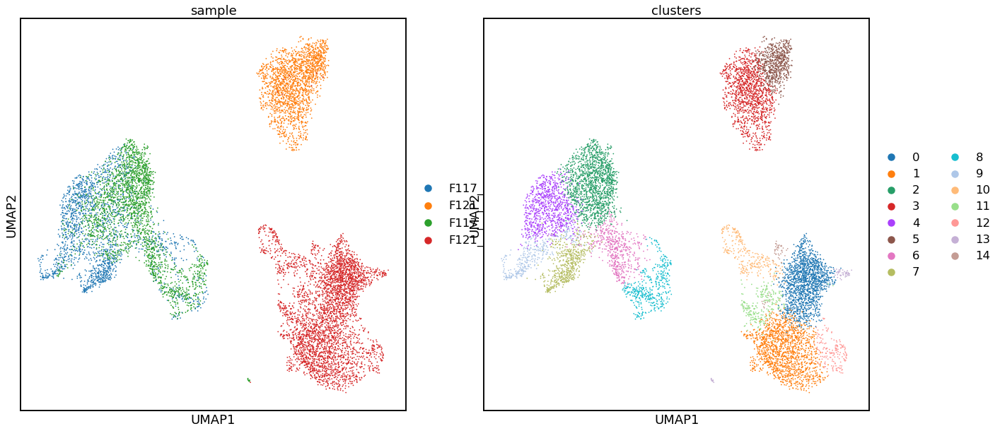

In [211]:
plt.rcParams['axes.facecolor'] = "white"
sc.pl.umap(org_adata, color=["sample","clusters"])

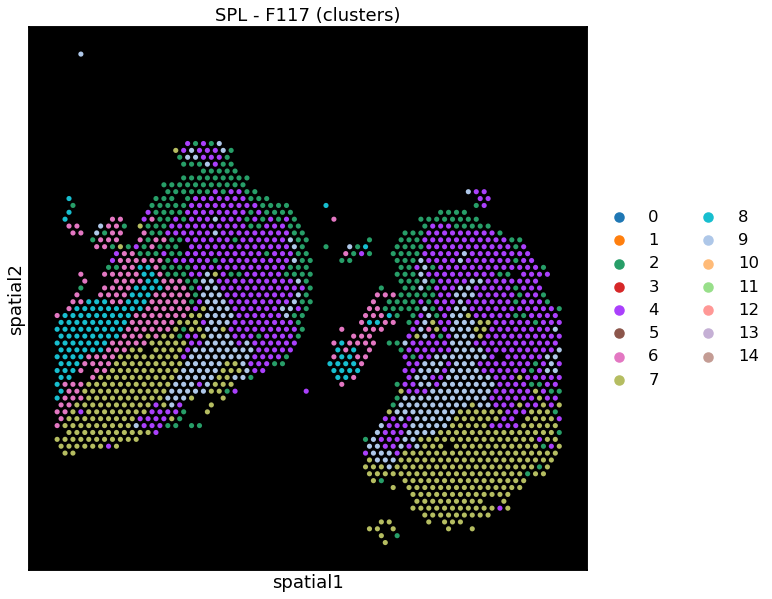

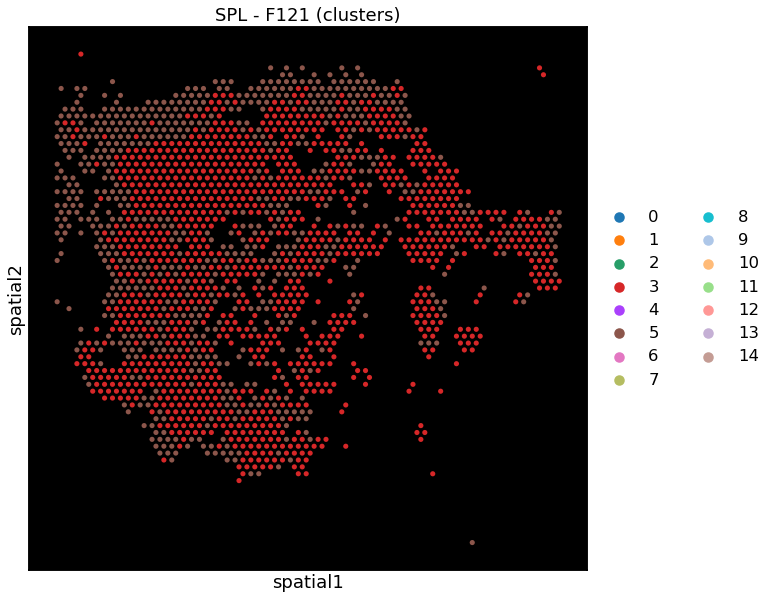

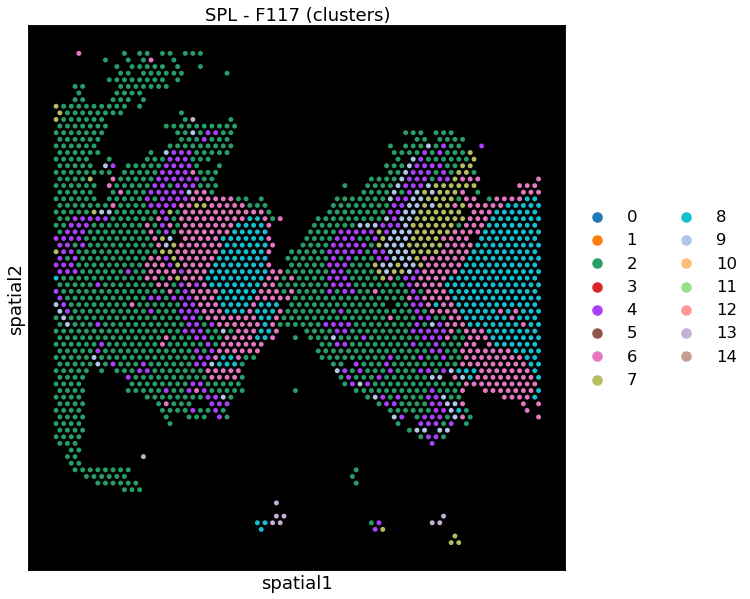

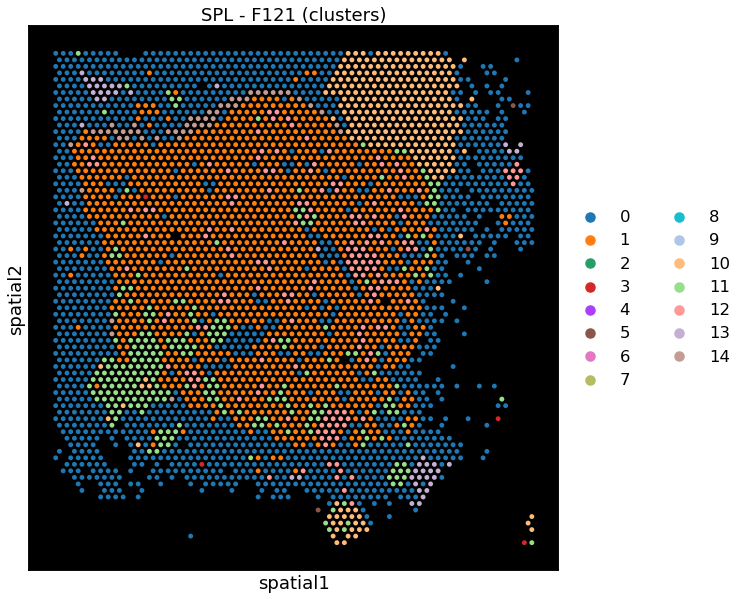

In [212]:
for a in org_adatas:
    plt.rcParams['axes.facecolor'] = "black"
    plt.rcParams["figure.figsize"] = [10,10]
    sns.set_context("talk")
    new_obs = org_adata.obs.loc[a.obs_names]
    a.obs = new_obs.copy()
    cols = ['clusters']
    sc.pl.spatial(a, color=cols, alpha_img=0,
                  title=["{o} - {d} ({c})".format(d=a.obs["donor"][0], o=a.obs["organ"][0], c=c) for c in cols]
                 )

In [207]:
org = "THY"

org_adatas = [a for a in adatas_keep if a.obs["organ"][0] == org]
samples = [a.obs["Sample"][0] for a in org_adatas]
org_adata = anndata.concat(org_adatas, label="sample", keys=samples)
org_hvgs = set(sum([list(a.var_names[a.var["highly_variable"]]) for a in org_adatas], []))
org_adata.var["highly_variable"] = org_adata.var_names.isin(org_hvgs)

sc.pp.pca(org_adata, use_highly_variable=True)
sc.pp.neighbors(org_adata)
sc.tl.umap(org_adata)
sc.tl.leiden(org_adata, key_added="clusters")

... storing 'data_path' as categorical
... storing 'Sample.lanes' as categorical
... storing 'Sample' as categorical


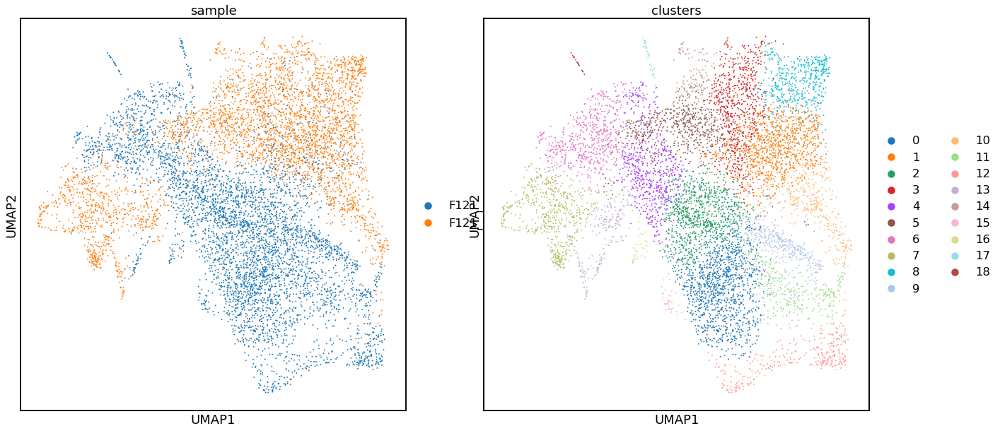

In [208]:
plt.rcParams['axes.facecolor'] = "white"
sc.pl.umap(org_adata, color=["sample","clusters"])

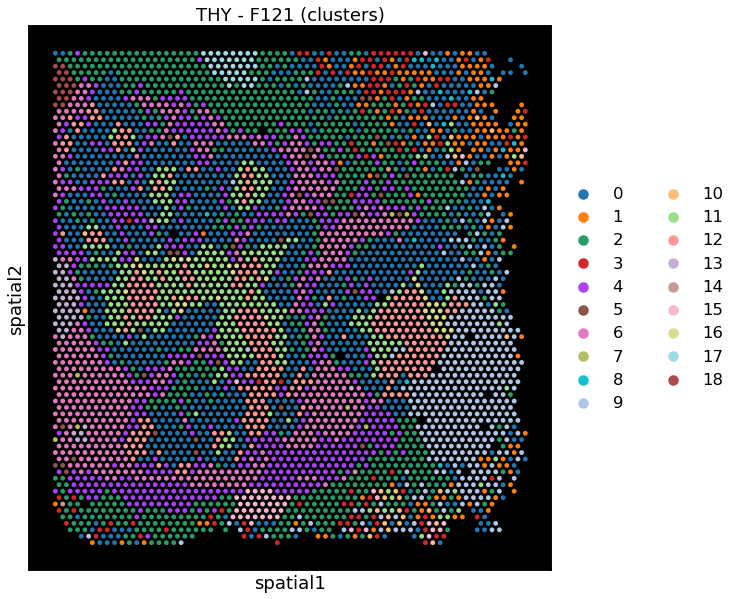

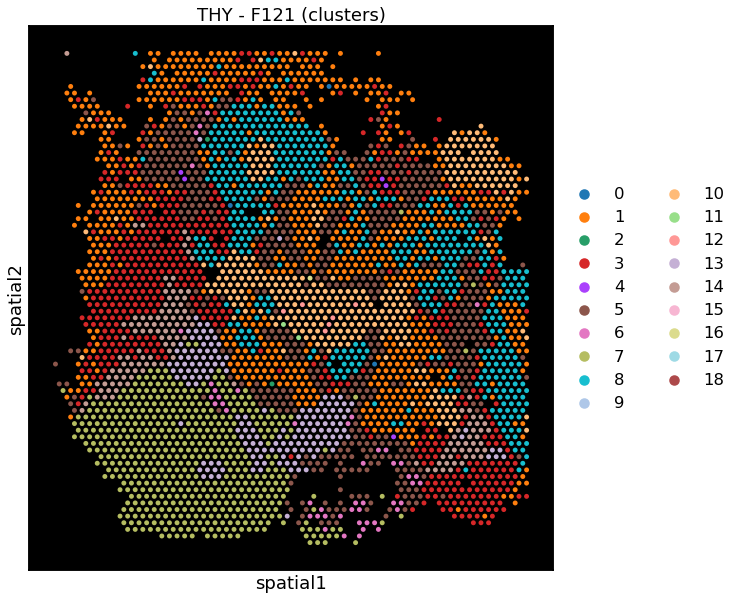

In [209]:
for a in org_adatas:
    plt.rcParams['axes.facecolor'] = "black"
    plt.rcParams["figure.figsize"] = [10,10]
    sns.set_context("talk")
    new_obs = org_adata.obs.loc[a.obs_names]
    a.obs = new_obs.copy()
    cols = ['clusters']
    sc.pl.spatial(a, color=cols, alpha_img=0,
                  title=["{o} - {d} ({c})".format(d=a.obs["donor"][0], o=a.obs["organ"][0], c=c) for c in cols]
                 )

### Save 

In [221]:
outdir="/nfs/team205/ed6/data/Fetal_immune/Visium/"
if not os.path.exists(outdir):
    os.mkdir(outdir)

for a in adatas_keep:
    filename = a.obs["Sample.lanes"][0] + "_" + a.obs["Sample"][0] + "_postQC.h5ad"
    a.write_h5ad(outdir + filename)